<a href="https://colab.research.google.com/github/linndemberg1/Computer-vision/blob/main/Trab6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Shape from shading**

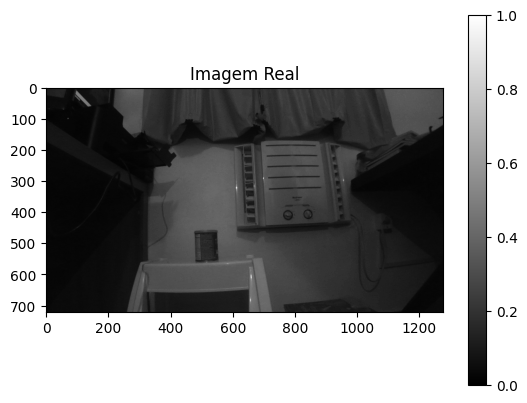

In [ ]:
import numpy as np
import plotly.graph_objs as go
from scipy.ndimage import gaussian_filter
from skimage import io, color
import matplotlib.pyplot as plt

# Caminho da imagem
image_path = '/content/trab6.png'

# Carregar a imagem
image = io.imread(image_path)

# Verificar se a imagem tem 4 canais (RGBA) e remover o canal alfa
if image.shape[-1] == 4:
    image = image[:, :, :3]

# Converter para escala de cinza se a imagem for colorida
if len(image.shape) == 3:
    image = color.rgb2gray(image)

# Normalizar a imagem para valores entre 0 e 1
image = (image - np.min(image)) / (np.max(image) - np.min(image))

# Suavizar a imagem para reduzir o ruído
image_smooth = gaussian_filter(image, sigma=1)

# Estimar as derivadas da imagem suavizada
dz_dx = np.gradient(image_smooth, axis=1)
dz_dy = np.gradient(image_smooth, axis=0)

# Estimar a forma (z) a partir dos gradientes
z = np.zeros_like(image_smooth)
z[1:, :] = np.cumsum(dz_dy[1:, :], axis=0)
z[:, 1:] += np.cumsum(dz_dx[:, 1:], axis=1)

# Exibir a imagem original
plt.imshow(image, cmap='gray')
plt.title("Imagem Real")
plt.colorbar()
plt.show()

# Gerar malha de coordenadas X, Y
X, Y = np.meshgrid(np.arange(z.shape[1]), np.arange(z.shape[0]))

# Visualizar a forma estimada como uma superfície 3D
fig = go.Figure(data=[go.Surface(z=z, x=X, y=Y, colorscale='Viridis')])
fig.update_layout(title='Forma Estimada (Shape from Shading)', autosize=False,
                  width=800, height=800, margin=dict(l=65, r=50, b=65, t=90))

fig.show()


## **Shape from motion**

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def shape_from_motion(image_path1, image_path2):
    # Carrega as imagens em escala de cinza
    image1 = cv2.imread(image_path1, cv2.IMREAD_GRAYSCALE)
    image2 = cv2.imread(image_path2, cv2.IMREAD_GRAYSCALE)

    # Inicializa o detector ORB para detectar keypoints e calcular descritores
    orb = cv2.ORB_create()
    keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
    keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

    # Realiza o pareamento dos descritores usando o BFMatcher com norma de Hamming
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors1, descriptors2)

    # Ordena as correspondências pela distância (melhores matches primeiro)
    matches = sorted(matches, key=lambda x: x.distance)

    # Extrai as coordenadas dos keypoints correspondentes
    pts1 = np.float32([keypoints1[m.queryIdx].pt for m in matches])
    pts2 = np.float32([keypoints2[m.trainIdx].pt for m in matches])

    # Calcula a matriz fundamental entre as duas vistas usando RANSAC
    F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC)

    # Filtra os pontos inliers identificados pelo RANSAC
    pts1 = pts1[mask.ravel() == 1]
    pts2 = pts2[mask.ravel() == 1]

    # Matriz intrínseca (assumida como identidade para simplificação)
    K = np.eye(3)

    # Calcula a matriz essencial a partir da matriz fundamental
    E = K.T @ F @ K

    # Recupera a rotação (R) e a translação (t) entre as duas vistas
    _, R, t, _ = cv2.recoverPose(E, pts1, pts2, K)

    # Converte os pontos para coordenadas homogêneas
    pts1_hom = cv2.convertPointsToHomogeneous(pts1).reshape(-1, 3).T
    pts2_hom = cv2.convertPointsToHomogeneous(pts2).reshape(-1, 3).T

    # Triangula os pontos 3D a partir das duas vistas
    points_3d_hom = cv2.triangulatePoints(np.eye(3, 4), np.hstack((R, t)), pts1_hom[:2], pts2_hom[:2])

    # Converte para coordenadas euclidianas normais
    points_3d = points_3d_hom[:3] / points_3d_hom[3]

    # Retorna os pontos 3D (x, y, z) e as coordenadas 2D na primeira imagem
    return points_3d.T, pts1

# Definição dos caminhos das imagens
img_left = './zed_div/Explorer_HD720_SN3299_12-52-45_left_half.png'
img_right = './zed_div/Explorer_HD720_SN3299_12-52-45_right_half.png'

# Obtenção dos pontos 3D e coordenadas 2D na primeira imagem
points_3d, pts1 = shape_from_motion(img_left, img_right)

def visualize_points_3d(image_path, points_3d, pts1):
    # Carrega a imagem original
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Exibe a imagem original e os pontos 3D projetados
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Imagem Original")
    plt.imshow(image, cmap='gray')

    plt.subplot(1, 2, 2)
    plt.title("Pontos 3D Projetados")
    plt.imshow(image, cmap='gray')
    plt.scatter(pts1[:, 0], pts1[:, 1], s=5, c='r')

    plt.show()

# Visualiza os pontos 3D na imagem
visualize_points_3d(img_left, points_3d, pts1)
